In [6]:
from PIL import Image
from PIL import ImageFilter
import cv2

import numpy as np
import matplotlib.pyplot as plt

In [7]:
PATH = 'data/im1.jpeg'

## Применение фильтров к фотографии
( Дарья Халенёва)

* 1. Фильтры с использованием PIL
* 2. Фильтры с использованием openCV
* 3. Свой фильтр (на основе openCV)

### 1. Фильтры с использованием PIL

In [8]:
'''
функция для визуальзации парных сконкатенированных изображений
'''

def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, min(im1.height, im2.height)))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

In [9]:
img = Image.open(PATH)

(-0.5, 1279.5, 959.5, -0.5)

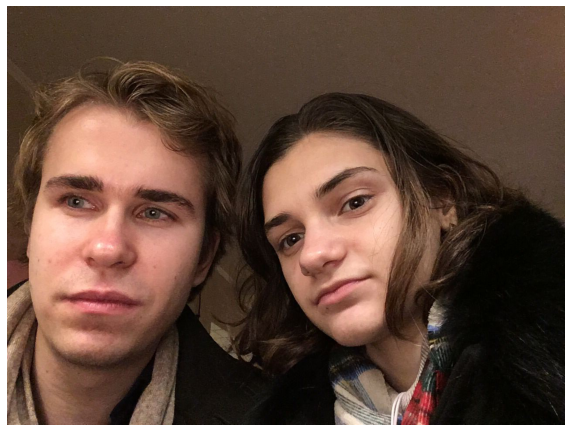

In [10]:
plt.rcParams['figure.figsize'] = (10.0, 8.0)
plt.imshow(img)
plt.axis('off')

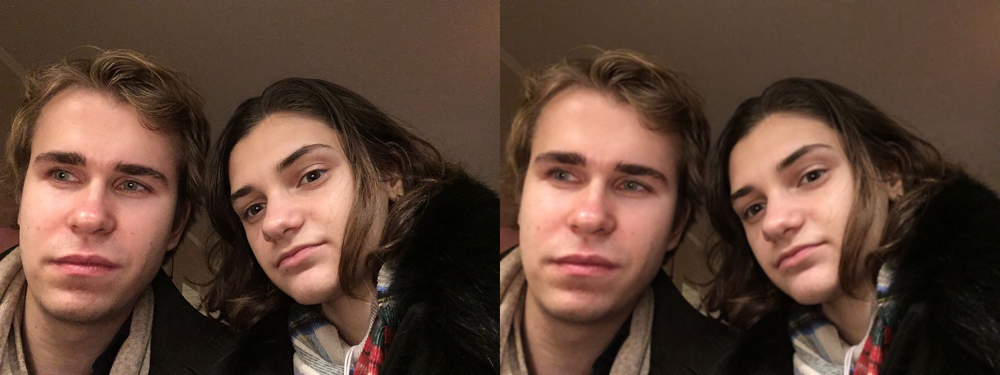

In [11]:
img_filtered = img.filter(ImageFilter.BLUR)
get_concat_h(img, img_filtered)

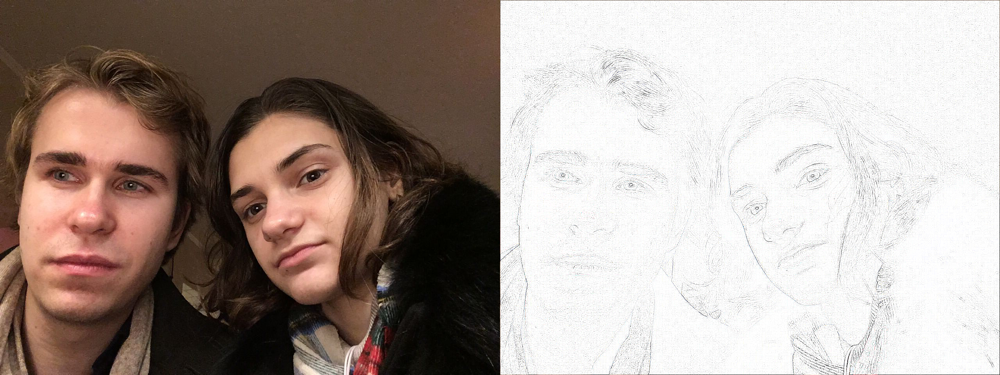

In [12]:
img_filtered = img.filter(ImageFilter.CONTOUR)
get_concat_h(img, img_filtered)

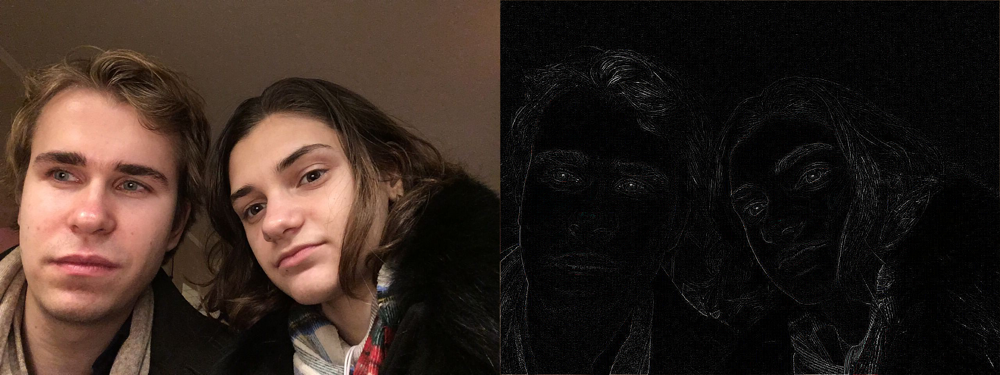

In [13]:
img_filtered = img.filter(ImageFilter.FIND_EDGES)
get_concat_h(img, img_filtered)

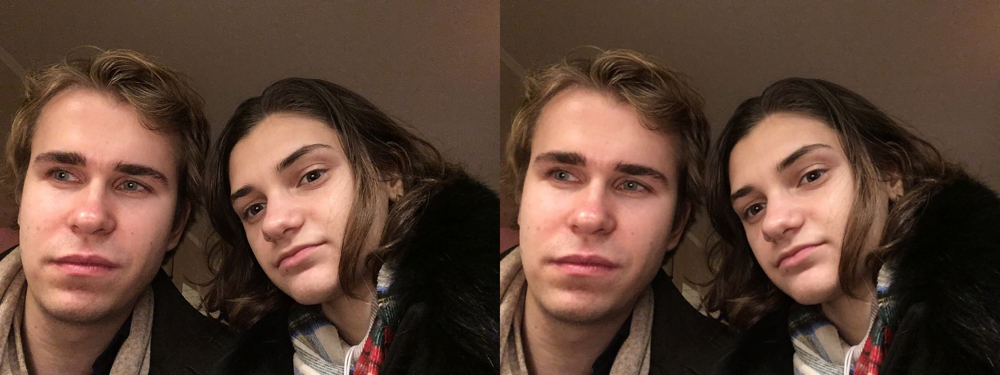

In [14]:
img_filtered = img.filter(ImageFilter.SMOOTH_MORE)
get_concat_h(img, img_filtered)

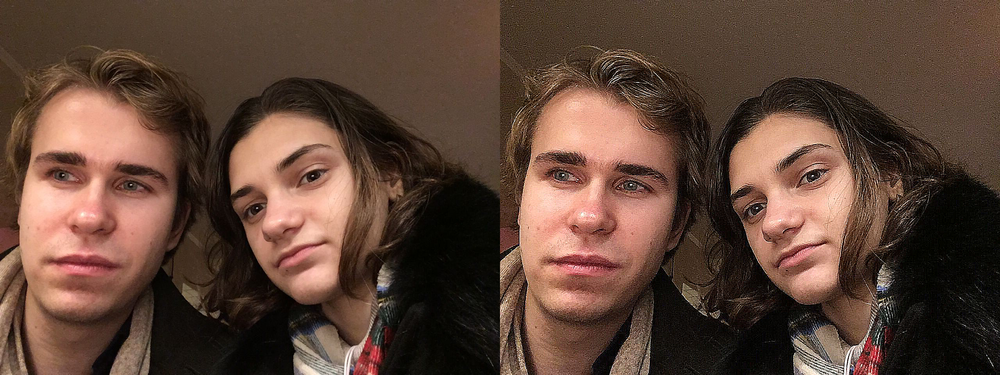

In [15]:
img_filtered = img.filter(ImageFilter.EDGE_ENHANCE_MORE)
get_concat_h(img, img_filtered)

### 2. Фильтры с использованием OpenCV 

In [16]:
img = cv2.imread(PATH)
img = cv2.resize(img, (0, 0), None, .25, .25)

Будем применять три фильтра: размытие по Гауссу, увеличение резкости и размытие по среднему

In [17]:
gaussianBlurKernel = np.array([[1, 2, 1], [2, 4, 2], [1, 2, 1]])/8
sharpenKernel = np.array([[0, -1, 0], [-1, 10, -1], [0, -1, 0]])/5
meanBlurKernel = np.ones((3, 3), np.float32)/8

gaussianBlur = cv2.filter2D(src=img, kernel=gaussianBlurKernel, ddepth=-1)
meanBlur = cv2.filter2D(src=img, kernel=meanBlurKernel, ddepth=-1)
sharpen = cv2.filter2D(src=img, kernel=sharpenKernel, ddepth=-1)

In [18]:
horizontalStack = np.concatenate((img, gaussianBlur, meanBlur, sharpen), axis=1)
cv2.imwrite("data/Output.jpg", horizontalStack)

True

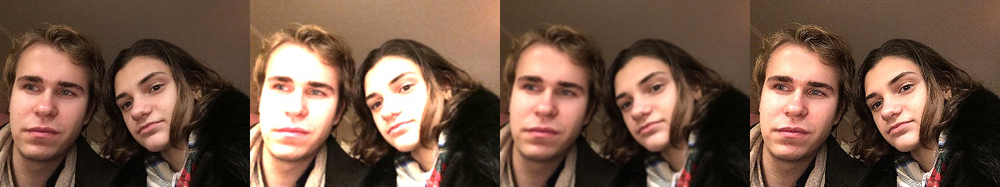

In [19]:
result = Image.open("data/Output.jpg")
result

### 3. Свой фильтр

In [45]:
MyKernel = np.array([[1, 0, 1], [0, 12, 0], [1, 0, 1]])/8
My_Filter = cv2.filter2D(src=img, kernel=MyKernel, ddepth = 0)

In [46]:
stack = np.concatenate((img, My_Filter), axis=1)
cv2.imwrite("data/My_filter.jpg", stack)

True

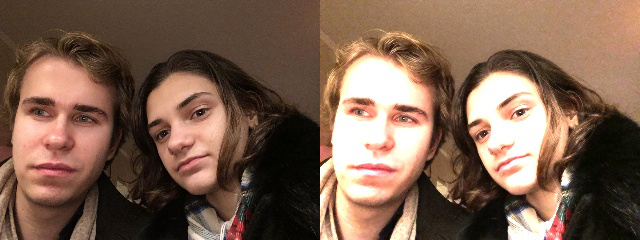

In [47]:
result = Image.open("data/My_filter.jpg")
result